# Análisis Exploratorio de Datos (EDA) - Google_Maps

## Introducción
Este documento presenta un Análisis Exploratorio de Datos (EDA) aplicado al conjunto de datos de Google_Maps. El objetivo principal es mejorar la comprensión de la información contenida en los archivos Parquet relacionados con banks, metadata y reviews

1. Nombres de Bancos Más Frecuentes
Identificación de los 10 nombres de bancos nacionales más frecuentes en todo Estados Unidos. Se presenta una visualización impactante a través de un gráfico de barras.

2. Histograma de Avg_rating
Comprensión de la distribución de las calificaciones promedio para evaluar la variabilidad de las puntuaciones en las reseñas.

3. Top Bancos y Características Principales
Identificación de los bancos con las puntuaciones promedio más altas y más bajas, destacando características distintivas.

4. Mapa de Dispersión
Visualización geoespacial de la ubicación de los bancos, resaltando la puntuación promedio y el número de reseñas para cada uno.

5. Mapa Interactivo
Presentación de las ubicaciones de los bancos de manera interactiva, proporcionando una experiencia más dinámica.

6. Distribución de Ratings
Visualización de la distribución de los ratings para obtener una comprensión de la proporción de reseñas positivas, negativas y neutrales.

7. Análisis Temporal
Graficación de la cantidad de reseñas a lo largo del tiempo utilizando un gráfico de líneas para observar tendencias y patrones en diferentes periodos temporales.

8. Análisis de Horarios
Exploración de la distribución de reseñas en función de las horas del día y análisis de posibles patrones de positividad o negatividad en diferentes momentos.

9. Palabras Más Frecuentes
Análisis de las palabras más frecuentes en las reseñas y creación de una nube de palabras de frecuencia para identificar términos clave.

10. Análisis de Usuarios
Identificación de los usuarios más activos y aquellos que han proporcionado reseñas más extremas (positivas o negativas).

11. Análisis de Tendencias de Sentimiento
Utilización de técnicas de procesamiento de lenguaje natural (NLP) para realizar un análisis de sentimientos en las reseñas y calcular el sentimiento promedio a lo largo del tiempo.

12. Mapa de Calor de Actividad
Creación de un mapa de calor para visualizar la actividad de reseñas en diferentes días y horas, permitiendo identificar patrones de actividad.



In [1]:
# Importar bibliotecas necesarias
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium

In [2]:
#Obtener la ruta del archivo
file_path = '../data/Cloud_Upload/Google_Maps/metadata/metadata.csv'

# Lee el archivo Parquet en un DataFrame
df_metadata = pd.read_csv(file_path)

# Muestra las primeras 5 fil
df_metadata.head(5)


,name,gmap_id,latitude,longitude,avg_rating,num_of_reviews,url
0,Gwinnett Community Bank,0x88f5a28359cb48cd:0xacc5f8fde9522f87,34.007883,-84.133413,3.0,2,https://www.google.com/maps/place//data=!4m2!3...
1,SouthState Bank,0x885831d2e81f802b:0x843f06a637f8b16c,34.846505,-82.397261,4.1,8,https://www.google.com/maps/place//data=!4m2!3...
2,Trustmark,0x887f9192fb220229:0x486fb6debed2b946,34.962989,-89.829834,4.2,5,https://www.google.com/maps/place//data=!4m2!3...
3,Central Bank,0x87c4c5c389616dd3:0x4349da2a75562d97,38.192834,-92.644184,4.5,44,https://www.google.com/maps/place//data=!4m2!3...
4,Lead Bank Crossroads,0x87c0f0420957bdcb:0xc5d1384c055cac32,39.091499,-94.583367,4.5,18,https://www.google.com/maps/place//data=!4m2!3...


In [3]:

# 10 nombres de bancos más frecuentes
df_metadata['name'].value_counts().head(10)


name
Chase Bank                               2511
Wells Fargo Bank                         2365
Bank of America (with Drive-thru ATM)    1212
U.S. Bank Branch                          945
PNC Bank                                  806
Bank of America Financial Center          587
TD Bank                                   567
BB&T                                      492
Regions Bank                              453
SunTrust                                  395
Name: count, dtype: int64

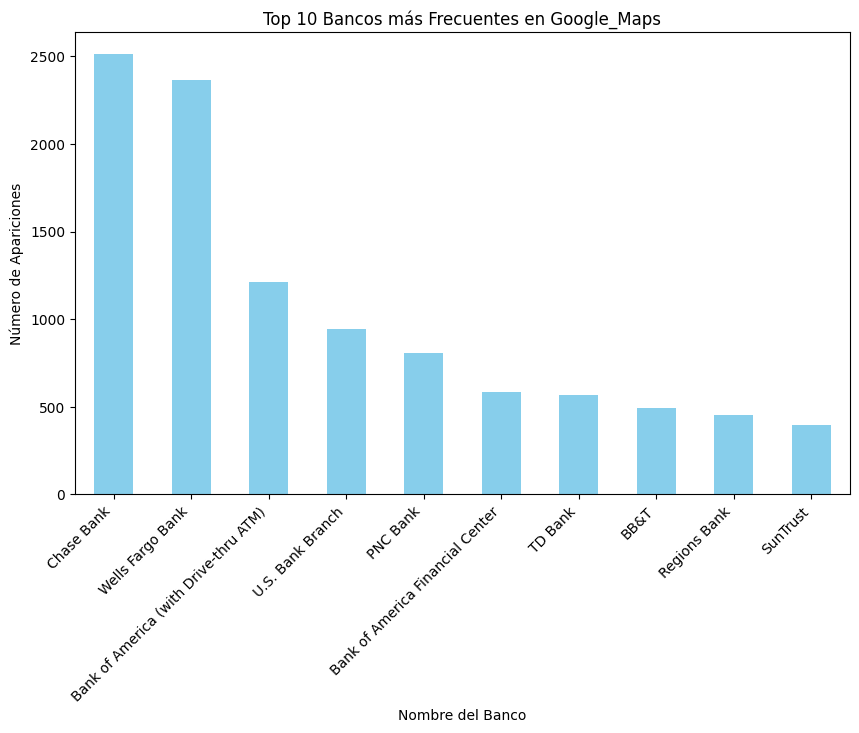

In [4]:
# Crea un gráfico de barras para los 10 bancos más frecuentes
plt.figure(figsize=(10, 6))
top_banks = df_metadata['name'].value_counts().head(10)
top_banks.plot(kind='bar', color='skyblue')
plt.title('Top 10 Bancos más Frecuentes en Google_Maps')
plt.xlabel('Nombre del Banco')
plt.ylabel('Número de Apariciones')
plt.xticks(rotation=45, ha='right')
plt.show()

    Estos datos muestran que Chase Bank, Wells Fargo Bank, Bank of America (with Drive-thru ATM), U.S. Bank Branch y PNC Bank son las instituciones más frecuentes. Todos estos son bancos nacionales bien establecidos con un amplio alcance en todo Estados Unidos.  
  

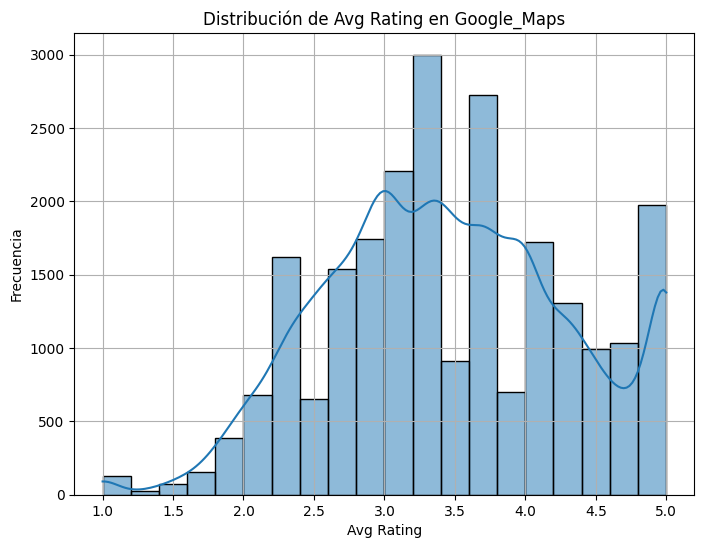

In [5]:
# Crea un histograma con etiquetas en los ejes
plt.figure(figsize=(8, 6))
sns.histplot(df_metadata['avg_rating'], bins=20, kde=True)
plt.title('Distribución de Avg Rating en Google_Maps')
plt.xlabel('Avg Rating')
plt.ylabel('Frecuencia')
plt.grid(True)  # Agrega una cuadrícula para mayor claridad
plt.show()

    La mayoría de las calificaciones se encuentran en el rango de 3.0 a 4.0, con una menor cantidad de calificaciones en los rangos más bajos y más altos.

    La curva superpuesta al histograma es una estimación de la densidad de probabilidad de la variable avg_rating.

C:\Users\Admin\AppData\Local\Temp\ipykernel_8604\1348411892.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='num_of_reviews', y='name', data=top_banks_reviews, palette='coolwarm')


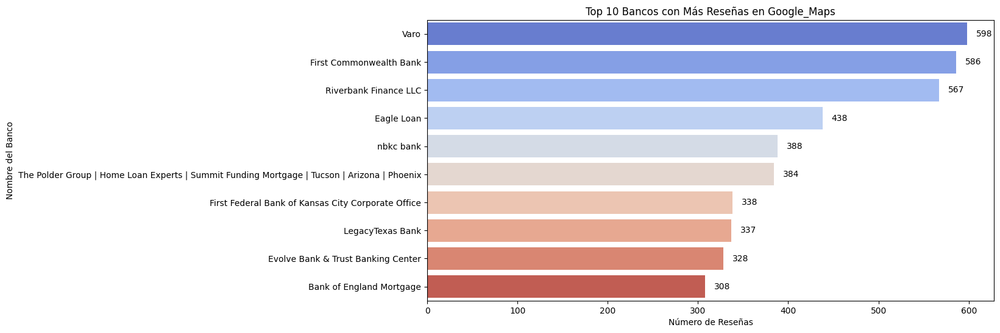

In [6]:
# Crea un gráfico de barras con números exactos de reseñas

top_banks_reviews = df_metadata.nlargest(10, 'num_of_reviews')
plt.figure(figsize=(12, 6))
sns.barplot(x='num_of_reviews', y='name', data=top_banks_reviews, palette='coolwarm')
for i, value in enumerate(top_banks_reviews['num_of_reviews']):
    plt.text(value + 10, i, str(value), va='center')
plt.title('Top 10 Bancos con Más Reseñas en Google_Maps')
plt.xlabel('Número de Reseñas')
plt.ylabel('Nombre del Banco')
plt.show()

    Podemos observar que los 10 bancos con más reseñas y sus respectivos números de reseñas, el banco Varo con 598 reseñas y el que menos tiene es Bank of England Mortgage con 308 reseñas

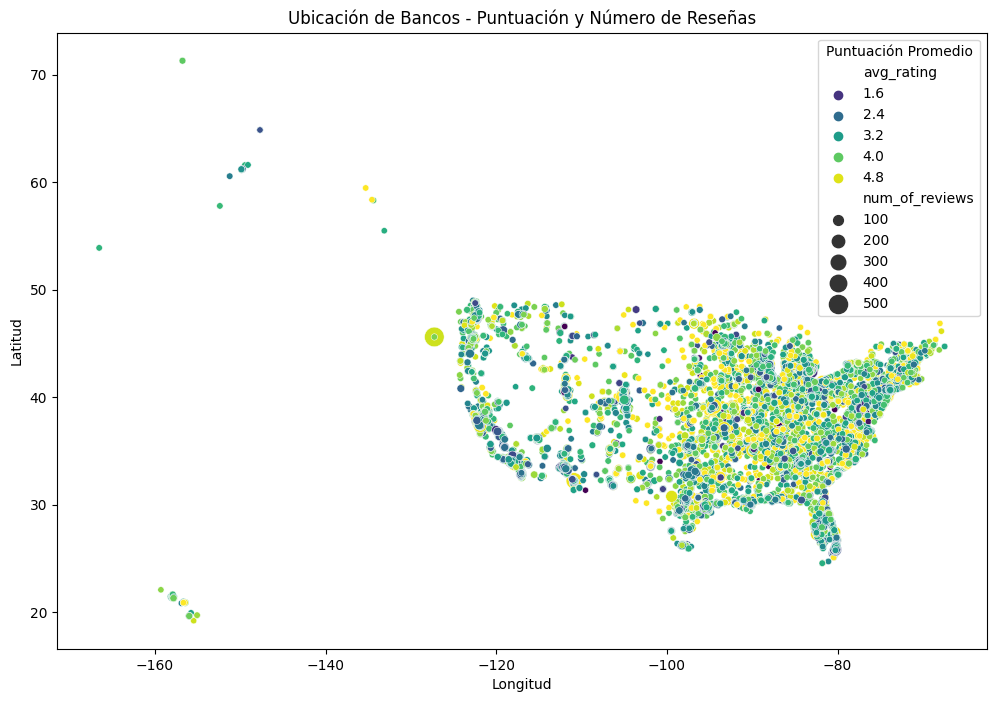

In [7]:
# Mapa de dispersión geoespacial
plt.figure(figsize=(12, 8))
sns.scatterplot(x='longitude', y='latitude', data=df_metadata, hue='avg_rating', palette='viridis', size='num_of_reviews', sizes=(20, 200))
plt.title('Ubicación de Bancos - Puntuación y Número de Reseñas')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.legend(title='Puntuación Promedio')
plt.show()

    Cada punto representa la ubicación geográfica de un banco. La posición en el mapa está determinada por las columnas 'longitude' (longitud) y 'latitude' (latitud) del DataFrame df_metadata, los puntos están coloreados según la puntuación promedio del banco ('avg_rating'), y el tamaño de los puntos está escalado por el número de reseñas ('num_of_reviews')

In [8]:
# Crea un mapa interactivo
mapa_interactivo = folium.Map(location=[40.7127, -74.0059], zoom_start=10)

# Agrega las ubicaciones de los bancos al mapa
for i in range(df_metadata.shape[0]):
    folium.Marker([df_metadata['latitude'].iloc[i], df_metadata['longitude'].iloc[i]], popup=df_metadata['name'].iloc[i]).add_to(mapa_interactivo)

# Guarda el mapa interactivo como archivo HTML
mapa_interactivo.save('mapa_interactivo_google_maps.html')

# Muestra el mapa
mapa_interactivo

In [9]:
#Obtener la ruta del archivo
file_path = '../data/Cloud_Upload/Google_Maps/reviews/reviews.csv'

# Lee el archivo Parquet en un DataFrame
df_reviews = pd.read_csv(file_path)

# Muestra las primeras 5 fila
df_reviews.head(5)

,user_id,name,time,rating,text,gmap_id,date,hour
0,1.030135e+20,Jarrod Jeffreys,22:10:00.705000,1,Terrible branch. Went in to make some simple u...,0x888e85137ff1c169:0xe7eafb5c7701aa2c,2021-07-21,22
1,1.014725e+20,Chad S,17:40:43.208000,1,Terrible bank! Horrible customer service! Incr...,0x888e85137ff1c169:0xe7eafb5c7701aa2c,2021-06-14,17
2,1.141050e+20,Rebecca Shipp,15:53:26.371000,1,This bank and the workers in this bank are LAZ...,0x888e85137ff1c169:0xe7eafb5c7701aa2c,2021-02-26,15
3,1.059413e+20,The Mopar Man,20:45:27.108000,5,I've been a Wells Fargo customer for over 10 y...,0x888e85137ff1c169:0xe7eafb5c7701aa2c,2019-12-17,20
4,1.107603e+20,Ken Hargroves,15:41:30.752000,1,This is absolutely the most infuriating Bank t...,0x888e85137ff1c169:0xe7eafb5c7701aa2c,2020-06-03,15


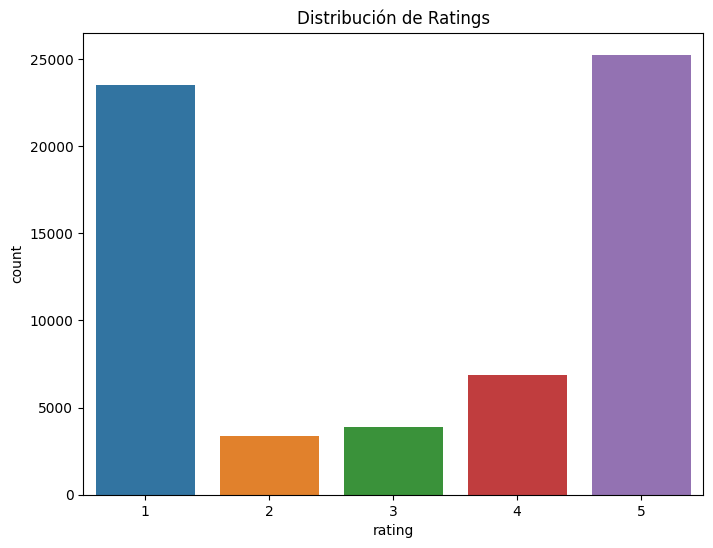

In [14]:
#  Distribución de Ratings
plt.figure(figsize=(8, 6))
sns.countplot(x='rating', data=df_reviews)
plt.title('Distribución de Ratings')
plt.show()

    Se observa una variación significativa en la distribución de los ratings. Los resultados revelan que el rating 5 destaca como la categoría más frecuente, con un total de 25,249 reseñas. En segundo lugar, el rating 1 sigue de cerca, acumulando 23,490 reseñas. La distribución continúa de la siguiente manera:

    Rating 4: 6,857 reseñas
    Rating 3: 3,899 reseñas
    Rating 2: 3,372 reseñas

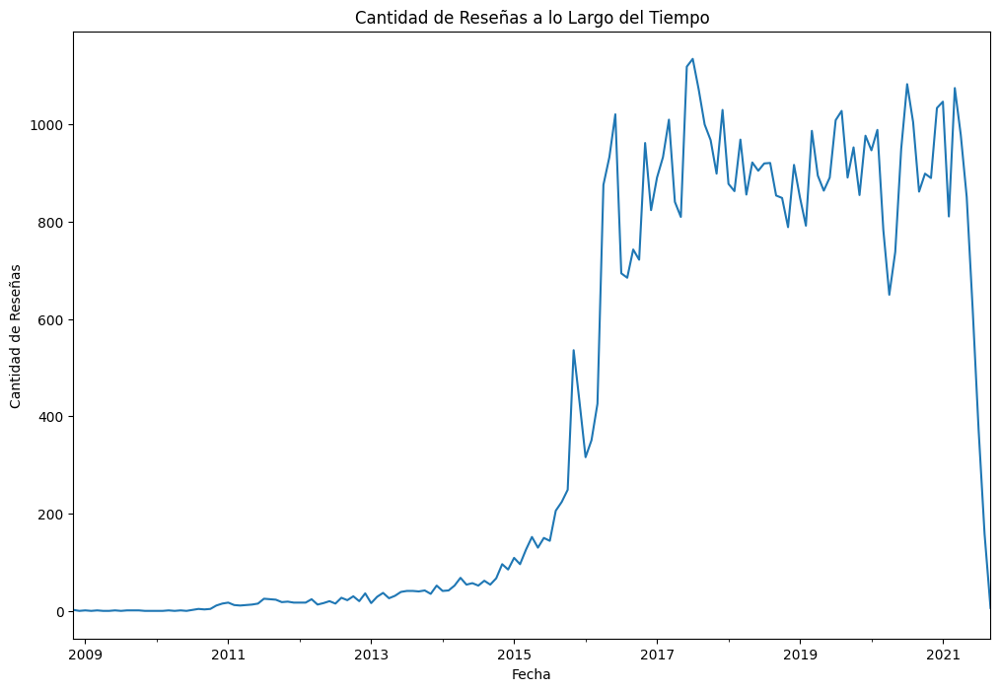

In [15]:
# Análisis Temporal
df_reviews['date'] = pd.to_datetime(df_reviews['date'])
df_reviews.set_index('date', inplace=True)
plt.figure(figsize=(12, 8))
df_reviews.resample('M').size().plot()
plt.title('Cantidad de Reseñas a lo Largo del Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Cantidad de Reseñas')
plt.show()

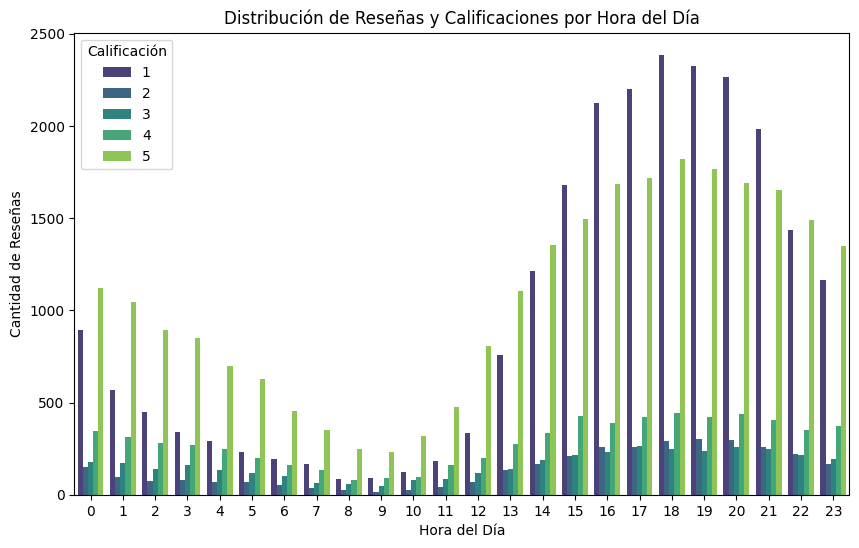

In [16]:
# Análisis de Horarios con Calificación
plt.figure(figsize=(10, 6))

# Crear el gráfico
sns.countplot(x='hour', hue='rating', data=df_reviews, palette='viridis')

# Configurar títulos y etiquetas
plt.title('Distribución de Reseñas y Calificaciones por Hora del Día')
plt.xlabel('Hora del Día')
plt.ylabel('Cantidad de Reseñas')
plt.legend(title='Calificación')

# Mostrar el gráfico
plt.show()

Análisis de Reseñas por Hora y Calificación

El análisis detallado de las reseñas por hora del día y calificación revela patrones interesantes en la interacción de los usuarios con el producto o servicio. Aquí se presentan algunas observaciones clave:

    - El total de reseñas analizadas asciende a 62,867, abarcando todas las calificaciones posibles (de 1 a 5).
    - La mayoría de las reseñas son calificaciones 5, indicando experiencias mayormente positivas
    - Algunas horas específicas destacan por tener una mayor proporción de calificaciones bajas (1 y 2), lo que podría indicar posibles áreas de mejora en esos momentos del día.

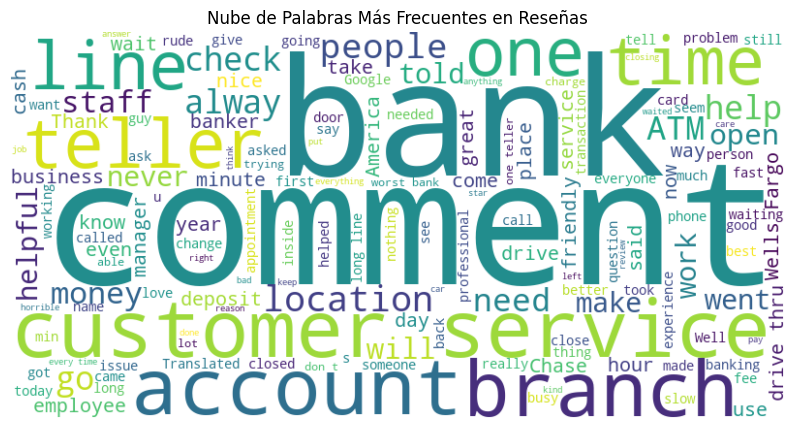

In [17]:
#  Palabras Más Frecuentes
from wordcloud import WordCloud

# Obtener las palabras más frecuentes
text = ' '.join(df_reviews['text'].astype(str))
wordcloud = WordCloud(width=800, height=400, max_words=150, background_color='white').generate(text)

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nube de Palabras Más Frecuentes en Reseñas')
plt.show()

## Analisis de usuarios. 

In [18]:
# Usuarios más activos
active_users = df_reviews['user_id'].value_counts().head(10)

# Reseñas más extremas
extreme_reviews = df_reviews[(df_reviews['rating'] == 1) | (df_reviews['rating'] == 5)].sort_values('rating')

active_users

user_id
1.033885e+20    236
1.032762e+20     33
1.115194e+20     29
1.018056e+20     28
1.130895e+20     22
1.125842e+20     19
1.030183e+20     17
1.016323e+20     17
1.112189e+20     15
1.139308e+20     14
Name: count, dtype: int64

    El usuario con el ID 1.033885e+20 es el más activo, con un total de 236 reseñas.
    Los usuarios siguientes en la lista también han contribuido significativamente con un número sustancial de reseñas.

## Análisis de Tendencias de Sentimiento

In [19]:
# Importar bibliotecas
from textblob import TextBlob
import matplotlib.pyplot as plt
import seaborn as sns

In [20]:

# Definir la función para obtener la etiqueta de Sentimiento
def get_sentiment_label(text):
    # Crear un objeto TextBlob
    blob = TextBlob(text)
    # Obtener la polaridad del sentimiento (-1 a 1)
    sentiment_polarity = blob.sentiment.polarity
    # Asignar etiquetas de sentimiento basadas en la polaridad
    if sentiment_polarity > 0:
        return "Positivo"
    elif sentiment_polarity < 0:
        return "Negativo"
    else:
        return "Neutral"

# Aplicar la función get_sentiment_label a todas las reseñas
df_reviews['sentiment'] = df_reviews['text'].apply(get_sentiment_label)

In [21]:
# Obtener la frecuencia de cada valor en la columna 'sentiment'
frecuencia_sentimientos = df_reviews['sentiment'].value_counts()

# Muestra la frecuencia de cada valor
print("Frecuencia de Sentimientos:")
print(frecuencia_sentimientos)

# Obtener la proporción de cada valor en la columna 'sentiment'
proporcion_sentimientos = df_reviews['sentiment'].value_counts(normalize=True)

# Muestra la proporción de cada valor
print("\nProporción de Sentimientos:")
print(proporcion_sentimientos)

Frecuencia de Sentimientos:
sentiment
Positivo    26537
Neutral     20940
Negativo    15390
Name: count, dtype: int64

Proporción de Sentimientos:
sentiment
Positivo    0.422113
Neutral     0.333084
Negativo    0.244803
Name: proportion, dtype: float64


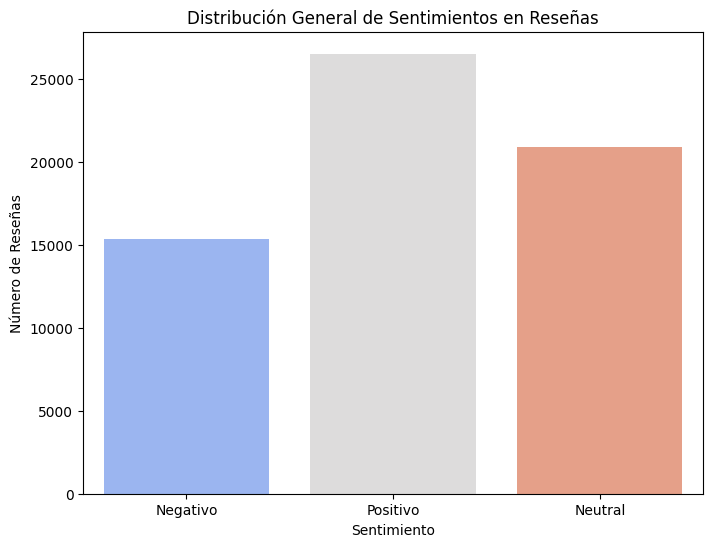

In [22]:
# Visualización de la distribución general de Sentimientos
plt.figure(figsize=(8, 6))
sns.countplot(x='sentiment', data=df_reviews, palette='coolwarm')
plt.title('Distribución General de Sentimientos en Reseñas')
plt.xlabel('Sentimiento')
plt.ylabel('Número de Reseñas')
plt.show()

    Frecuencia de Sentimientos:

    Positivo: 26537 reseñas
    Neutral: 20940 reseñas
    Negativo: 15390 reseñas

Esto significa que hay 26537 reseñas clasificadas como "Positivo", 20940 reseñas clasificadas como "Neutral" y 15390 reseñas clasificadas como "Negativo".

    Proporción de Sentimientos:

    Positivo: 0.422113 (42.21%)
    Neutral: 0.333084 (33.31%)
    Negativo: 0.244803 (24.48%)

Esto muestra la proporción de cada categoría de sentimiento con respecto al total de reseñas. El 42.21% de las reseñas son positivas, el 33.31% son neutrales y el 24.48% son negativa

## Mapa de Calor de Actividad

In [25]:
print(df_reviews['date'].dtype)


object


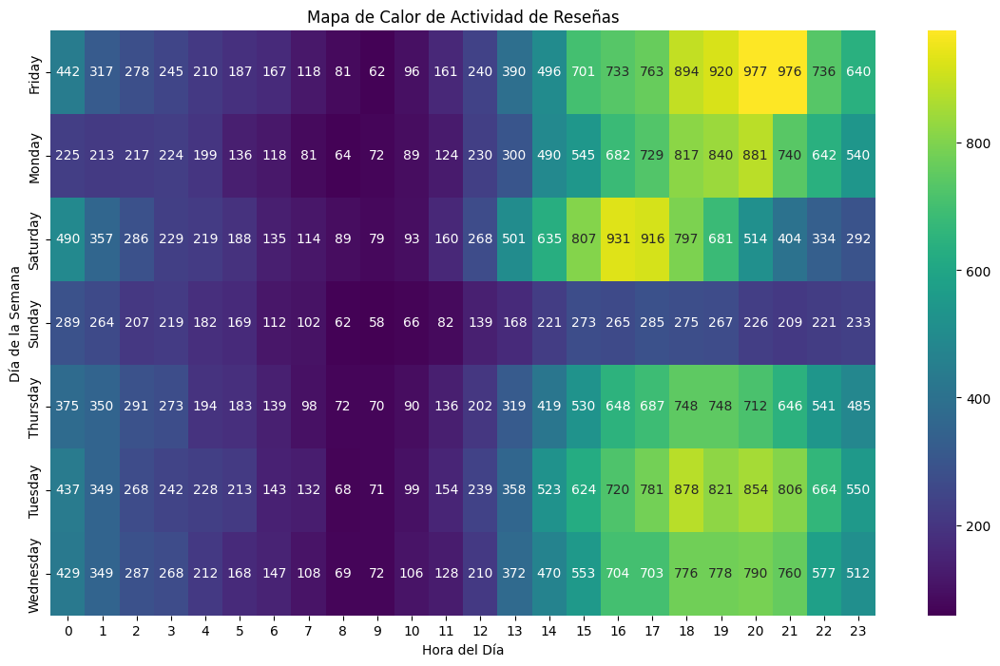

In [26]:
#  Convertir la columna 'date' a datetime
df_reviews['date'] = pd.to_datetime(df_reviews['date'])

# Mapa de Calor de Actividad
df_reviews['day'] = df_reviews['date'].dt.day_name()
df_reviews['hour'] = df_reviews['hour'].astype(int)

heatmap_data = df_reviews.pivot_table(index='day', columns='hour', values='rating', aggfunc='count')
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='g')
plt.title('Mapa de Calor de Actividad de Reseñas')
plt.xlabel('Hora del Día')
plt.ylabel('Día de la Semana')
plt.show()

    El mapa de calor muestra la cantidad de reseñas por día y hora. Destacan picos de actividad los viernes a las 8:00 PM y los sábados a las 9:00 PM. Se observan variaciones diarias, siendo los sábados por la tarde/noche momentos populares. 

# Conclusiones del Análisis Exploratorio de Datos (EDA) de Google_Maps

Proporciona una visión detallada de la distribución y características de los bancos en Estados Unidos:

* Nombres de Bancos más Frecuentes:

    Se identificaron los 10 nombres de bancos más frecuentes, destacando que Chase Bank, Wells Fargo Bank y Bank of America son las instituciones más comunes y bien establecidas a nivel nacional.

* Histograma de Avg_rating:

    La mayoría de las calificaciones se encuentran en el rango de 3.0 a 4.0, indicando que la mayoría de los bancos tienen una calificación aceptable. Este análisis puede ser útil para comprender la percepción general de los usuarios sobre los bancos en el conjunto de datos.

* Top Bancos con Más Reseñas:

    Se identificaron los bancos con más reseñas, con Varo liderando la lista con 598 reseñas. Incluir el número exacto de reseñas en las barras facilita una referencia rápida.

* Mapa de Dispersión Geoespacial:

    El mapa de dispersión geoespacial resalta la ubicación de los bancos con colores que representan las puntuaciones promedio y tamaños que indican el número de reseñas. Se observa una distribución geográfica de los bancos y cómo varían en popularidad y puntuación en diferentes regiones.

* Mapa Interactivo:

    Nos permite una exploración más detallada y personalizada de la ubicación de los bancos. 
